In [ ]:
###### Installing

!pip install kaggle
!pip install nibabel
!pip install split-folders

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 32.4 MB/s eta 0:00:00


In [ ]:
pip install nibabel


In [ ]:
!pip install numpy tensorflow keras matplotlib nibabel splitfolders opencv-python scipy pillow scikit-learn mpl_toolkits
!pip install scikit-image


ERROR: Could not find a version that satisfies the requirement splitfolders (from versions: none)
ERROR: No matching distribution found for splitfolders


In [ ]:
!pip install opencv-python-headless --quiet
!pip install --no-cache-dir tensorflow --quiet


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.0/50.0 MB 22.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.9/644.9 MB 201.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 256.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.5/24.5 MB 202.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 214.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.1/5.1 MB 118.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 218.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 345.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.5/72.5 kB 202.5 MB/s eta 0:00:00


In [ ]:
###### Importing Libraries

from google.colab import files
import shutil
import os
import glob
import numpy as np
import random
import tensorflow as tf
import keras
import matplotlib.pyplot as plt
import nibabel as nib
import splitfolders
import cv2
import scipy.ndimage
import tensorflow.keras.backend as K
from PIL import Image
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import MinMaxScaler
from scipy.ndimage import rotate, zoom
from scipy.ndimage import gaussian_filter, map_coordinates
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.models import Model
from keras.layers import Input, Conv3D, MaxPooling3D, concatenate, Conv3DTranspose, BatchNormalization, Dropout, Lambda
from keras.optimizers import Adam
from keras.metrics import MeanIoU
from keras.regularizers import l2
from keras.regularizers import l1_l2
from sklearn.metrics import accuracy_score
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from skimage import measure

In [ ]:
###### Importing the BraTS2020 Datset from kaggle

# Use the file picker to upload the Kaggle API key
uploaded = files.upload()

!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

# Downloading
!kaggle datasets download -d awsaf49/brats20-dataset-training-validation
# Unzipping the downloaded file
!unzip brats20-dataset-training-validation.zip

Saving kaggle.json to kaggle.json
Dataset URL: https://www.kaggle.com/datasets/awsaf49/brats20-dataset-training-validation
License(s): CC0-1.0
Archive:  brats20-dataset-training-validation.zip
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_flair.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_seg.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t1.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t1ce.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t2.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_002/BraTS20_Training_002_flair.nii  
  inflating: BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_002/BraTS20_T

In [ ]:
###### Loading the data

shutil.rmtree('/content/BraTS2020_ValidationData')
shutil.rmtree('/content/sample_data')
current_path = "/content/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData"
new_path = "/content/MICCAI_BraTS2020_TrainingData"
shutil.move(current_path, new_path)
shutil.rmtree('/content/BraTS2020_TrainingData')
os.remove("/content/MICCAI_BraTS2020_TrainingData/name_mapping.csv")
os.remove("/content/MICCAI_BraTS2020_TrainingData/survival_info.csv")
current_name = "/content/MICCAI_BraTS2020_TrainingData/BraTS20_Training_355/W39_1998.09.19_Segm.nii"
new_name = "/content/MICCAI_BraTS2020_TrainingData/BraTS20_Training_355/BraTS20_Training_355_seg.nii"
os.rename(current_name, new_name)

In [ ]:
###### Creating lists for T2 and Mask data

t2_list=sorted(glob.glob('/content/MICCAI_BraTS2020_TrainingData/*/*t2.nii'))
mask_list=sorted(glob.glob('/content/MICCAI_BraTS2020_TrainingData/*/*seg.nii'))
t2_list=t2_list[:200]
mask_list=mask_list[:200]
print(len(t2_list))
print(len(mask_list))

200
200


In [ ]:
os.makedirs('/content/input_data/images')
os.makedirs('/content/input_data/masks')

In [ ]:
###### Basic Preprocessing

scaler=MinMaxScaler()

for img in range(len(mask_list)):
    # Load the niffti file and extarct float numpy array because it is easier to work with
    image=nib.load(t2_list[img]).get_fdata()

    # Scale the pixel values between 0 and 1, we have to flatten the image for the scaler
    #   converting the 3D image data into a 2D array, where each row represents a slice of the image
    image=scaler.fit_transform(image.reshape(-1, image.shape[-1])).reshape(image.shape)

    mask=nib.load(mask_list[img]).get_fdata()

    # Converting float to uint8 since we only have integers
    mask=mask.astype(np.uint8)

    # Reassign mask values 4 to 3, since 3 is empty
    mask[mask==4]=3

    # Crop to 128x128x128 to remove useless space, keeping only the volume of interest
    #   and if we'll use patches later, the size will be divisible by 64 to extract 64x64x64 patches
    image=image[56:184, 56:184, 13:141]
    mask=mask[56:184, 56:184, 13:141]

    # Keeping data that has at least 1% useful volume with labels that are not 0
    values, counts=np.unique(mask, return_counts=True)
    # Converting the masks to categorical data
    mask = to_categorical(mask, num_classes=4)

    # Saving the NumPy data
    np.save('/content/input_data/images/image_'+str(img)+'.npy', image)
    np.save('/content/input_data/masks/mask_'+str(img)+'.npy', mask)

# Removing the no longer usefull folder
shutil.rmtree('/content/MICCAI_BraTS2020_TrainingData')

In [ ]:
###### Splitting the data into training, validation, and testing

input_folder = '/content/input_data'
os.makedirs('/content/input_data_final')
output_folder = '/content/input_data_final/'
splitfolders.ratio(input_folder, output=output_folder, seed=42, ratio=(0.7, 0.2, 0.1), group_prefix=None)

# Removing the no longer usefull folder
shutil.rmtree("/content/input_data")

Copying files: 400 files [09:39,  1.45s/ files]


In [ ]:
###### Custom data generator

# keras data generator doesn't work with nii or 3D numpy files
def load_img(img_dir, img_list):
    images=[]
    for i, image_name in enumerate(img_list):
        if (image_name.split('.')[1]=='npy'):
            image=np.load(img_dir+image_name)
            images.append(image)
    images=np.array(images)
    return(images)

In [ ]:
###### Data Augmentation Functions

def elastic_deformation(image, mask, alpha=1000, sigma=15):
    # Generate random displacement fields
    dx = np.random.uniform(-1, 1, image.shape)
    dy = np.random.uniform(-1, 1, image.shape)
    dz = np.random.uniform(-1, 1, image.shape)
    # Smooth the displacement fields
    dx = gaussian_filter(dx, sigma, mode="reflect")
    dy = gaussian_filter(dy, sigma, mode="reflect")
    dz = gaussian_filter(dz, sigma, mode="reflect")
    # Generate deformed coordinates
    x, y, z = np.meshgrid(np.arange(image.shape[0]), np.arange(image.shape[1]), np.arange(image.shape[2]), indexing="ij")
    indices = (
        np.clip(np.round(x + dx * alpha).astype(int), 0, image.shape[0] - 1),
        np.clip(np.round(y + dy * alpha).astype(int), 0, image.shape[1] - 1),
        np.clip(np.round(z + dz * alpha).astype(int), 0, image.shape[2] - 1))
    # Apply deformation to image
    deformed_image = image[indices]
    # Apply deformation to mask
    deformed_mask = mask[indices]
    return deformed_image, deformed_mask

def apply_data_augmentation(image_batch, mask_batch):
    augmented_image_batch = []
    augmented_mask_batch = []

    for i in range(len(image_batch)):
        image = image_batch[i]
        mask = mask_batch[i]

        # Apply horizontal flip
        if np.random.rand() > 0.5:
            image = np.flip(image, axis=0)
            mask = np.flip(mask, axis=0)

        # Apply elastic deformation
        image, mask = elastic_deformation(image, mask)

        # Apply contrast and brightness adjustment
        alpha = 1.0 + np.random.uniform(-0.05, 0.05) # Contrast
        beta = np.random.uniform(-0.2, 0.2) # Brightness
        image = np.clip(image * alpha + beta, 0, 1)

        # Add the augmented data
        augmented_image_batch.append(image)
        augmented_mask_batch.append(mask)

    return np.array(augmented_image_batch), np.array(augmented_mask_batch)

In [ ]:
###### Custom data Loader

def imageLoader(img_dir, img_list, mask_dir, mask_list, batch_size):
    n=len(img_list)
    # Keras needs an infinite generator
    while True:
        batch_start=0
        batch_end=batch_size
        while batch_start<n:
            limit=min(batch_end, n)
            X=load_img(img_dir, img_list[batch_start:limit])
            Y=load_img(mask_dir, mask_list[batch_start:limit])
            # yield suspends the execution and return a value,
            #   but enables the function to resume where it left off
            yield (X, Y)
            batch_start += batch_size
            batch_end += batch_size

In [ ]:
###### Custom data Loader with Augmentation

def imageLoaderAugmented(img_dir, img_list, mask_dir, mask_list, batch_size):
    n = len(img_list)

    while True:
        batch_start = 0
        batch_end = batch_size
        while batch_start < n:
            limit = min(batch_end, n)
            X = load_img(img_dir, img_list[batch_start:limit])
            Y = load_img(mask_dir, mask_list[batch_start:limit])
            # Apply data augmentation on the batch
            X_augmented, Y_augmented = apply_data_augmentation(X, Y)
            # Yield the augmented batch
            yield (X_augmented, Y_augmented)
            batch_start += batch_size
            batch_end += batch_size

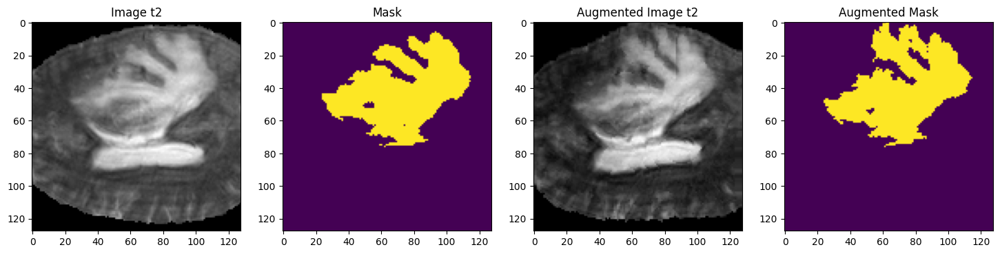

In [ ]:
###### Visualizing Samples, with and without augmentation

# Loading the data
train_img_dir="/content/input_data_final/train/images/"
train_mask_dir="/content/input_data_final/train/masks/"
train_img_list=sorted(os.listdir(train_img_dir))
train_mask_list=sorted(os.listdir(train_mask_dir))

batch_size = 2

train_img_gen = imageLoader(train_img_dir, train_img_list, train_mask_dir,
                            train_mask_list, batch_size)
train_img_gen_aug = imageLoaderAugmented(train_img_dir, train_img_list, train_mask_dir,
                            train_mask_list, batch_size)

# Load a batch
img, msk = train_img_gen.__next__()
img_aug, msk_aug = train_img_gen_aug.__next__()

# Load a random image and its mask
img_num = random.randint(0,img.shape[0]-1)
test_img=img[img_num]
test_mask=msk[img_num]
test_img_aug=img_aug[img_num]
test_mask_aug=msk_aug[img_num]

# Convert the one-hot encoded categorical values into integers
test_mask=np.argmax(test_mask, axis=3)
test_mask_aug=np.argmax(test_mask_aug, axis=3)

# Load a slice
n_slice=random.randint(10, test_mask.shape[2]-1)

# Plot the slice
plt.figure(figsize=(18, 14))
plt.subplot(141)
plt.imshow(test_img[:,:,n_slice], cmap='gray')
plt.title('Image t2')
plt.subplot(142)
plt.imshow(test_mask[:,:,n_slice])
plt.title('Mask')
plt.subplot(143)
plt.imshow(test_img_aug[:,:,n_slice], cmap='gray')
plt.title('Augmented Image t2')
plt.subplot(144)
plt.imshow(test_mask_aug[:,:,n_slice])
plt.title('Augmented Mask')
plt.show()

In [ ]:
###### Defining the loss function

def dice_coefficient(y_true, y_pred, smooth=1e-5):
    intersection = K.sum(y_true * y_pred)
    union = K.sum(y_true) + K.sum(y_pred)
    dice = (2.0 * intersection + smooth) / (union + smooth)
    return dice

def dice_loss(y_true, y_pred):
    return 1.0 - dice_coefficient(y_true, y_pred)

def focal_loss(y_true, y_pred, gamma=2.0, alpha=0.25):
    y_pred = K.clip(y_pred, K.epsilon(), 1.0 - K.epsilon())
    loss = -alpha * y_true * K.pow(1.0 - y_pred, gamma) * K.log(y_pred) - (1 - alpha) * (1 - y_true) * K.pow(y_pred, gamma) * K.log(1.0 - y_pred)
    return K.mean(loss, axis=-1)

def dice_plus_focal_loss(y_true, y_pred):
    # Calculate Dice loss
    dice = dice_loss(y_true, y_pred)

    # Calculate Focal loss
    focal = focal_loss(y_true, y_pred)

    # Combine the losses
    alpha = 1.0  # Weighting factor for Dice loss
    beta = 1.0   # Weighting factor for Focal loss
    combined_loss = alpha * dice + beta * focal

    return combined_loss

In [ ]:
###### Defining the model

def simple_unet_model(IMG_HEIGHT, IMG_WIDTH, IMG_DEPTH, IMG_CHANNELS, num_classes, activation, dropout, kernel_initializer, kernel_regularizer):

    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_DEPTH, IMG_CHANNELS))

    ### Contractive path
    c1 = Conv3D(16, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(inputs)
    c1 = BatchNormalization(axis=-1)(c1)
    c1 = Conv3D(16, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(c1)
    c1 = Dropout(dropout)(c1)
    p1 = MaxPooling3D((2, 2, 2))(c1)

    c2 = Conv3D(32, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(p1)
    c2 = BatchNormalization(axis=-1)(c2)
    c2 = Conv3D(32, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(c2)
    c2 = Dropout(dropout)(c2)
    p2 = MaxPooling3D((2, 2, 2))(c2)

    c3 = Conv3D(64, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(p2)
    c3 = BatchNormalization(axis=-1)(c3)
    c3 = Conv3D(64, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(c3)
    c3 = Dropout(dropout)(c3)
    p3 = MaxPooling3D((2, 2, 2))(c3)

    c4 = Conv3D(128, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(p3)
    c4 = BatchNormalization(axis=-1)(c4)
    c4 = Conv3D(128, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(c4)
    c4 = Dropout(dropout)(c4)
    p4 = MaxPooling3D(pool_size=(2, 2, 2))(c4)

    c5 = Conv3D(256, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(p4)
    c5 = BatchNormalization(axis=-1)(c5)
    c5 = Conv3D(256, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(c5)
    c5 = Dropout(dropout)(c5)
    c5 = Dropout(dropout)(c5)

    ### Expansive path
    u6 = Conv3DTranspose(128, (2, 2, 2), strides=(2, 2, 2), padding='same')(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv3D(128, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(u6)
    c6 = Conv3D(128, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(c6)
    c6 = Dropout(dropout)(c6)

    u7 = Conv3DTranspose(64, (2, 2, 2), strides=(2, 2, 2), padding='same')(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv3D(64, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(u7)
    c7 = Conv3D(64, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(c7)
    c7 = Dropout(dropout)(c7)

    u8 = Conv3DTranspose(32, (2, 2, 2), strides=(2, 2, 2), padding='same')(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv3D(32, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(u8)
    c8 = Conv3D(32, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(c8)
    c8 = Dropout(dropout)(c8)

    u9 = Conv3DTranspose(16, (2, 2, 2), strides=(2, 2, 2), padding='same')(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv3D(16, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(u9)
    c9 = Conv3D(16, (3, 3, 3), activation=activation, kernel_initializer=kernel_initializer, padding='same')(c9)
    c9 = Dropout(dropout)(c9)

    outputs = Conv3D(num_classes, (1, 1, 1), activation='softmax')(c9)

    model = Model(inputs=[inputs], outputs=[outputs])

    return model

In [ ]:
###### Defining the metrics

metrics = ['accuracy', MeanIoU(num_classes=4)]

In [ ]:
###### Preparing the data for the input to the model

# Training data
train_img_dir="/content/input_data_final/train/images/"
train_mask_dir="/content/input_data_final/train/masks/"
train_img_list=sorted(os.listdir(train_img_dir))
train_mask_list=sorted(os.listdir(train_mask_dir))

val_img_dir="/content/input_data_final/val/images/"
val_mask_dir="/content/input_data_final/val/masks/"
val_img_list=sorted(os.listdir(val_img_dir))
val_mask_list=sorted(os.listdir(val_mask_dir))

# Batch size for training
batch_size = 4

# Create data generators
train_img_gen_aug = imageLoaderAugmented(train_img_dir, train_img_list, train_mask_dir, train_mask_list, batch_size)
train_img_gen = imageLoader(train_img_dir, train_img_list, train_mask_dir, train_mask_list, batch_size)
val_img_gen = imageLoader(val_img_dir, val_img_list, val_mask_dir, val_mask_list, batch_size)

# Steps per epoch and validation steps
steps_per_epoch = len(train_img_list) // batch_size
validation_steps = len(val_img_list) // batch_size

In [ ]:
###### Declaring and compiling the model

model = simple_unet_model(128, 128, 128, 1, 4, activation = 'relu', dropout = 0.2, kernel_initializer =  'he_uniform', kernel_regularizer = 'none')
model.compile(optimizer = Adam(learning_rate=0.001), loss=dice_plus_focal_loss, metrics=metrics)

print(model.summary())
print(model.input_shape)
print(model.output_shape)

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 128, 128, 128,  │              0 │ -                      │
│                           │ 1)                     │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d (Conv3D)           │ (None, 128, 128, 128,  │            448 │ input_layer[0][0]      │
│                           │ 16)                    │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 128, 128, 128,  │             64 │ conv3d[0][0]           │
│ (BatchNormalization)      │ 16)                    │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_1 (Conv3D)         │ (None, 128, 128, 128,  │          6,928 │ batch_normalization[0… │
│                           │ 16)                    │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout (Dropout)         │ (None, 128, 128, 128,  │              0 │ conv3d_1[0][0]         │
│                           │ 16)                    │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d             │ (None, 64, 64, 64, 16) │              0 │ dropout[0][0]          │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_2 (Conv3D)         │ (None, 64, 64, 64, 32) │         13,856 │ max_pooling3d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 64, 64, 64, 32) │            128 │ conv3d_2[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_3 (Conv3D)         │ (None, 64, 64, 64, 32) │         27,680 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_1 (Dropout)       │ (None, 64, 64, 64, 32) │              0 │ conv3d_3[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_1           │ (None, 32, 32, 32, 32) │              0 │ dropout_1[0][0]        │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_4 (Conv3D)         │ (None, 32, 32, 32, 64) │         55,360 │ max_pooling3d_1[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 32, 32, 32, 64) │            256 │ conv3d_4[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_5 (Conv3D)         │ (None, 32, 32, 32, 64) │        110,656 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_2 (Dropout)       │ (None, 32, 32, 32, 64) │              0 │ conv3d_5[0][0]         │
├──────────────────────

 Total params: 5,646,948 (21.54 MB)

 Trainable params: 5,645,956 (21.54 MB)

 Non-trainable params: 992 (3.88 KB)

None
(None, 128, 128, 128, 1)
(None, 128, 128, 128, 4)


In [ ]:
###### Train the model on the Original Data

history_1 = model.fit(train_img_gen,
                        steps_per_epoch=4,
                        epochs=2,
                        validation_data=val_img_gen,
                        validation_steps=validation_steps,
                        verbose=1)

Epoch 1/2
4/4 ━━━━━━━━━━━━━━━━━━━━ 812s 223s/step - accuracy: 0.9623 - loss: 0.1144 - mean_io_u: 0.3750 - val_accuracy: 0.9565 - val_loss: 0.3662 - val_mean_io_u: 0.3750
Epoch 2/2
4/4 ━━━━━━━━━━━━━━━━━━━━ 812s 221s/step - accuracy: 0.9516 - loss: 0.1216 - mean_io_u: 0.3750 - val_accuracy: 0.9566 - val_loss: 0.4266 - val_mean_io_u: 0.3750


In [ ]:
###### Train the pretrained model on the Augmented Data

history_2 = model.fit(train_img_gen_aug,
                        steps_per_epoch=4,
                        epochs=2,
                        validation_data=val_img_gen,
                        validation_steps=validation_steps,
                        verbose=1)

Epoch 1/2
4/4 ━━━━━━━━━━━━━━━━━━━━ 825s 225s/step - accuracy: 0.9466 - loss: 0.1341 - mean_io_u: 0.3750 - val_accuracy: 0.9565 - val_loss: 0.4527 - val_mean_io_u: 0.3750
Epoch 2/2
4/4 ━━━━━━━━━━━━━━━━━━━━ 815s 222s/step - accuracy: 0.9444 - loss: 0.1264 - mean_io_u: 0.3750 - val_accuracy: 0.9566 - val_loss: 0.4030 - val_mean_io_u: 0.3750


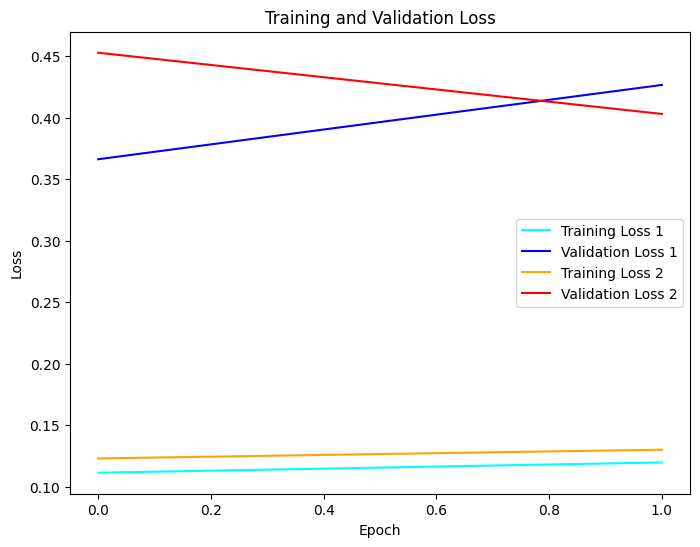

In [ ]:
###### Plot the training and validation loss

plt.figure(figsize=(8, 6))
plt.plot(history_1.history['loss'], label='Training Loss 1', c='cyan')
plt.plot(history_1.history['val_loss'], label='Validation Loss 1', c='blue')
plt.plot(history_2.history['loss'], label='Training Loss 2', c='orange')
plt.plot(history_2.history['val_loss'], label='Validation Loss 2', c='red')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

In [ ]:
# Save the entire model (architecture + weights + optimizer state)
model.save("Brats_3D-UNET_200epNoAug.hdf5")


In [ ]:
    ###### Load the pre-trained model: 200ep on the original data & 120ep on the augmented data

    tf.keras.losses.dice_plus_focal_loss = dice_plus_focal_loss
    model = tf.keras.models.load_model('./Brats_3D-UNET_200epNoAug.hdf5',
                                    custom_objects={'dice_plus_focal_loss': dice_plus_focal_loss})

In [ ]:
###### Predictions metrics

test_img_dir="/content/input_data_final/test/images/"
test_mask_dir="/content/input_data_final/test/masks/"
test_img_list=sorted(os.listdir(test_img_dir))
test_mask_list=sorted(os.listdir(test_mask_dir))

test_img_gen = imageLoader(test_img_dir, test_img_list, test_mask_dir, test_mask_list, batch_size)
test_image_batch, test_mask_batch = test_img_gen.__next__()

n_classes = 4
IOU_keras = MeanIoU(num_classes=n_classes)

test_mask_batch_argmax = np.argmax(test_mask_batch, axis=4)
test_pred_batch = model.predict(test_image_batch)
test_pred_batch_argmax = np.argmax(test_pred_batch, axis=4)

IOU_keras.update_state(test_pred_batch_argmax, test_mask_batch_argmax)
print("Mean IoU =", IOU_keras.result().numpy())

test_mask_batch_flat = test_mask_batch_argmax.flatten()
test_pred_batch_flat = test_pred_batch_argmax.flatten()
accuracy = accuracy_score(test_mask_batch_flat, test_pred_batch_flat)
print("Accuracy =", accuracy)

1/1 ━━━━━━━━━━━━━━━━━━━━ 10s 10s/step
Mean IoU = 0.23854417
Accuracy = 0.954176664352417


1/1 ━━━━━━━━━━━━━━━━━━━━ 10s 10s/step


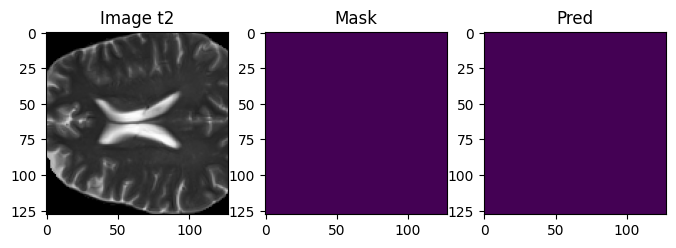

In [ ]:
###### Visualize the predictions

test_img_dir="/content/input_data_final/test/images/"
test_mask_dir="/content/input_data_final/test/masks/"
test_img_list=sorted(os.listdir(test_img_dir))
test_mask_list=sorted(os.listdir(test_mask_dir))

batch_size = 2

test_img_gen = imageLoader(test_img_dir, test_img_list, test_mask_dir, test_mask_list, batch_size)

# Load a batch
img, msk = test_img_gen.__next__()

# Predict
test_prediction = model.predict(img)

# Load a random image and its mask
img_num = random.randint(0,img.shape[0]-1)
test_img=img[img_num]
test_mask=msk[img_num]
pred_mask=test_prediction[img_num]

# Convert the one-hot encoded categorical values into integers
test_mask=np.argmax(test_mask, axis=3)
pred_mask=np.argmax(pred_mask, axis=3)

# Load a slice
n_slice=random.randint(0, test_mask.shape[2])

# Plotting
plt.figure(figsize=(8, 18))
plt.subplot(131)
plt.imshow(test_img[:,:,n_slice], cmap='gray')
plt.title('Image t2')
plt.subplot(132)
plt.imshow(test_mask[:,:,n_slice])
plt.title('Mask')
plt.subplot(133)
plt.imshow(pred_mask[:,:,n_slice])
plt.title('Pred')
plt.show()

In [ ]:
# Loading the data
train_img_dir="/content/input_data_final/train/images/"
train_mask_dir="/content/input_data_final/train/masks/"
train_img_list=sorted(os.listdir(train_img_dir))
train_mask_list=sorted(os.listdir(train_mask_dir))

batch_size = 2

train_img_gen = imageLoader(train_img_dir, train_img_list, train_mask_dir,
                            train_mask_list, batch_size)

# Loading a batch
img, msk = train_img_gen.__next__()

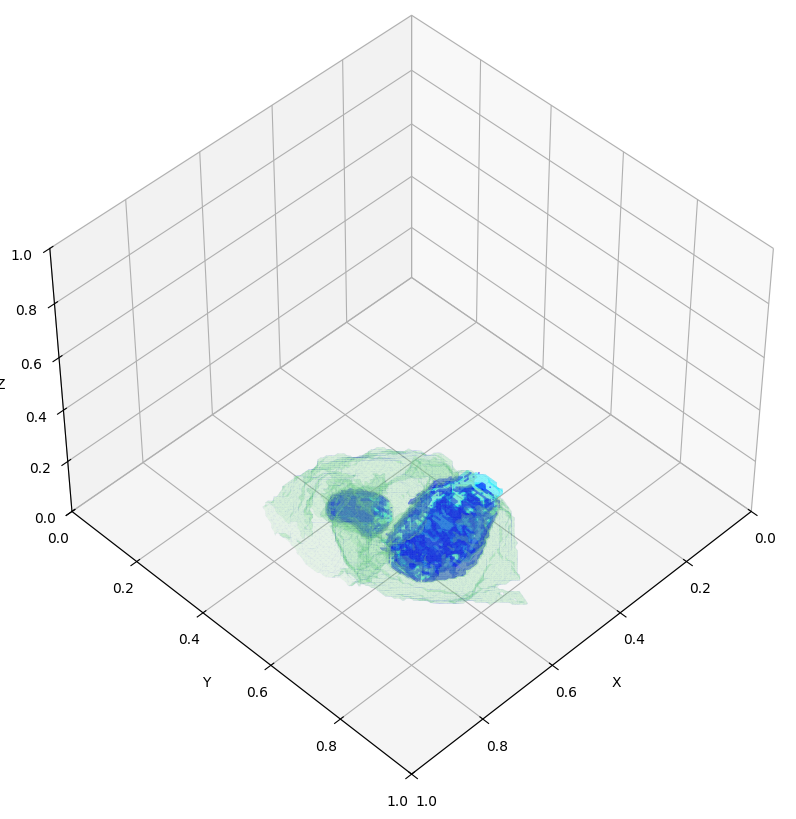

In [ ]:
###### 3D Plot for the Tumor

def plot_3d_tumor(segmentation_mask):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    num_classes = segmentation_mask.shape[-1]
    colors = ['black', 'blue', 'lightgreen', 'cyan']
    alpha = [1, 0.35, 0.15, 0.25]

    for class_idx in range(1,segmentation_mask.shape[-1]):
        mask = segmentation_mask[..., class_idx]

        verts, faces, _, _ = measure.marching_cubes(mask, level=0.7)
        verts = verts / np.array(mask.shape)

        num_triangles = len(faces)
        verts = verts[faces]
        verts = verts.reshape((num_triangles, 3, 3))

        mesh = Poly3DCollection(verts, alpha=alpha[class_idx], linewidths=0.003, edgecolors='b')
        mesh.set_facecolor(colors[class_idx])
        ax.add_collection3d(mesh)

    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_zlim(0, 1)

    ax.view_init(elev=45, azim=45)  # Set the view angle
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.grid(True)
    plt.show()

# Example
plot_3d_tumor(msk[1])

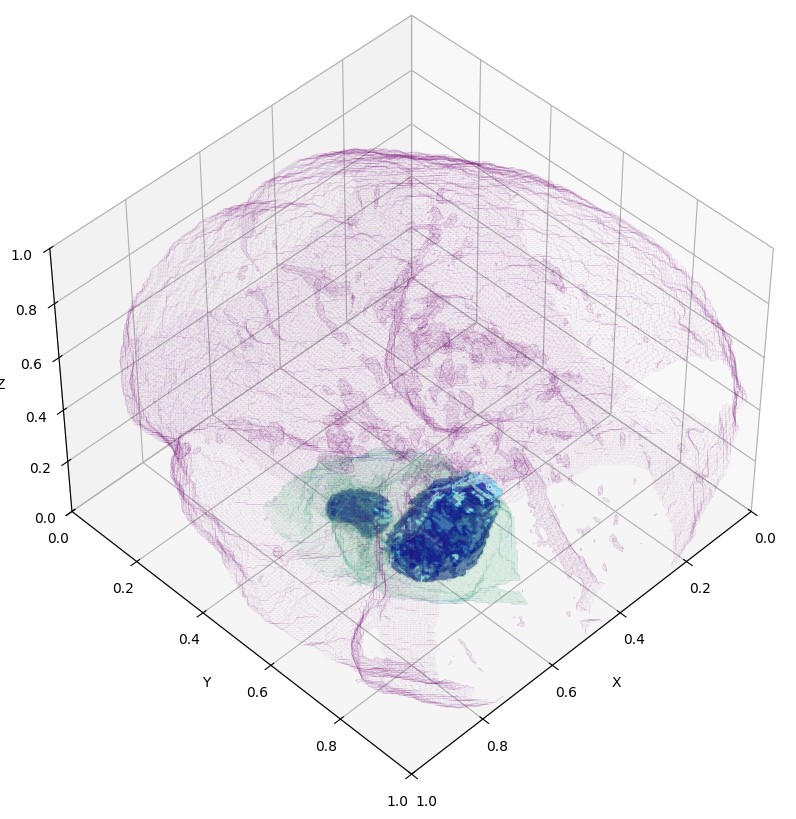

In [ ]:
###### 3D Plot for the Tumor inside the Organ

def plot_3d_segmentation_mask_with_mri(segmentation_mask, mri_data):
    fig = plt.figure(figsize=(15, 10))
    ax = fig.add_subplot(111, projection='3d')

    num_classes = segmentation_mask.shape[-1]
    colors = ['black', 'darkblue', 'lightgreen', 'cyan']
    alpha = [1, 0.35, 0.1, 0.15]

    for class_idx in range(1, num_classes):
        mask = segmentation_mask[..., class_idx]

        verts, faces, _, _ = measure.marching_cubes(mask, level=0.7)
        verts = verts / np.array(mask.shape)

        num_triangles = len(faces)
        verts = verts[faces]
        verts = verts.reshape((num_triangles, 3, 3))

        mesh = Poly3DCollection(verts, alpha=alpha[class_idx], linewidths=0.003, edgecolors='b')
        mesh.set_facecolor(colors[class_idx])
        ax.add_collection3d(mesh)

    # Plot the MRI data
    mask = mri_data[..., class_idx]

    verts, faces, _, _ = measure.marching_cubes(mri_data, level=0.16)
    verts = verts / np.array(mri_data.shape)

    num_triangles = len(faces)
    verts = verts[faces]
    verts = verts.reshape((num_triangles, 3, 3))

    mesh = Poly3DCollection(verts, alpha=0.0005, linewidths=0.01, edgecolors='purple')
    mesh.set_facecolor('lightgray')
    ax.add_collection3d(mesh)

    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_zlim(0, 1)

    ax.view_init(elev=45, azim=45)  # Set the view angle
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.grid(True)

    plt.show()

# Example
plot_3d_segmentation_mask_with_mri(msk[1], img[1])

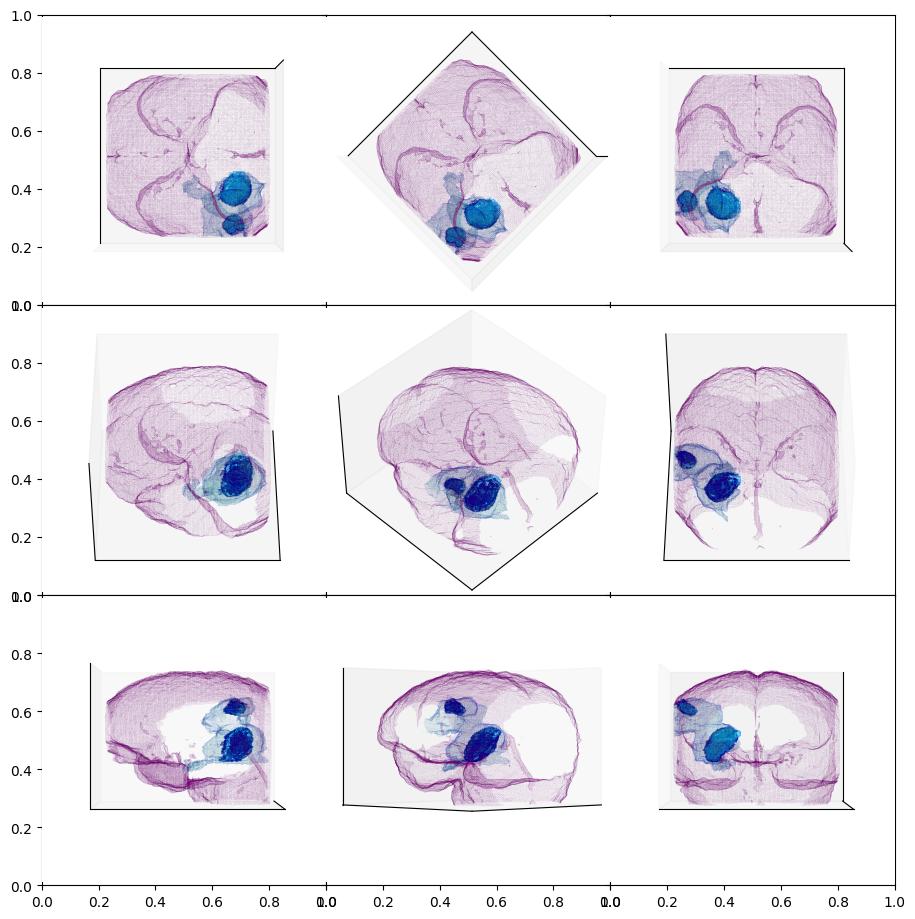

In [ ]:
###### 3D Plot for the Tumor inside the Organ with multiple angles

def plot_3d_multiple_segmentation_mask_with_mri(segmentation_mask, mri_data):

    fig, axs = plt.subplots(3, 3, figsize=(9, 9), sharex=True, sharey=True)
    axs = axs.ravel()

    num_classes = segmentation_mask.shape[-1]
    colors = ['black', 'darkblue', 'lightgreen', 'cyan']
    alpha = [1, 0.35, 0.1, 0.25]
    angles = [0, 45, 90]
    elevs = [90, 45, 0]

    k = 0

    for elev in elevs:
      for angle_idx, angle in enumerate(angles):
        ax = axs[angle_idx]
        ax.clear()
        ax = fig.add_subplot(3, 3, angle_idx + 1 + k, projection='3d')
        #ax.axis('off')  # Turn off the axes

        for class_idx in range(1, num_classes):
          mask = segmentation_mask[..., class_idx]

          verts, faces, _, _ = measure.marching_cubes(mask, level=0.7)
          verts = verts / np.array(mask.shape)

          num_triangles = len(faces)
          verts = verts[faces]
          verts = verts.reshape((num_triangles, 3, 3))

          mesh = Poly3DCollection(verts, alpha=alpha[class_idx], linewidths=0.003, edgecolors='b')
          mesh.set_facecolor(colors[class_idx])
          ax.add_collection3d(mesh)

        # Plot the MRI data
        mask = mri_data[..., class_idx]
        verts, faces, _, _ = measure.marching_cubes(mri_data, level=0.12)
        verts = verts / np.array(mri_data.shape)
        num_triangles = len(faces)
        verts = verts[faces]
        verts = verts.reshape((num_triangles, 3, 3))
        mesh = Poly3DCollection(verts, alpha=0, linewidths=0.006, edgecolors='purple')
        mesh.set_facecolor('lightgray')
        ax.add_collection3d(mesh)
        ax.view_init(elev=elev, azim=angle)  # Set the view angle
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_zticks([])
        #ax.axis('off')

      k += 3

    fig.tight_layout(pad=0)
    plt.subplots_adjust(hspace=0, wspace=0)
    plt.show()

# Example
plot_3d_multiple_segmentation_mask_with_mri(msk[1], img[1])

In [ ]:
###### GIF showing the 3 different planes of the MRI and the tumor masks

def create_mri_gif_1(msk, img, output_gif):
    num_slices = msk.shape[0]

    # Create an empty list to store the individual MRI slice images
    images = []

    for i in range(num_slices):
        # Select the MRI slice and corresponding mask
        mri_slice1 = img[:, :, i]
        mask1 = msk[:, :, i, 1:4]
        mri_slice2 = img[:, i, :]
        mask2 = msk[:, i, :, 1:4]
        mri_slice3 = img[i, :, :]
        mask3 = msk[i, :, :, 1:4]

        # Create a figure with two subplots
        fig, axes = plt.subplots(3, 3, figsize=(9, 9))
        axes = axes.ravel()

        # Display the MRI slice
        axes[0].imshow(mri_slice1, cmap='gray')
        axes[0].set_title('MRI Slice')

        # Display the MRI Slice with tumor mask
        axes[1].imshow(mri_slice1, cmap='gray')
        axes[1].imshow(mask1, alpha=0.3)
        axes[1].set_title('MRI Slice with Tumor Mask')

        # Display the tumor mask
        axes[2].imshow(mask1)
        axes[2].set_title('Tumor Mask')

        axes[3].imshow(mri_slice2, cmap='gray')
        axes[4].imshow(mri_slice2, cmap='gray')
        axes[4].imshow(mask2, alpha=0.3)
        axes[5].imshow(mask2)

        axes[6].imshow(mri_slice3, cmap='gray')
        axes[7].imshow(mri_slice3, cmap='gray')
        axes[7].imshow(mask3, alpha=0.3)
        axes[8].imshow(mask3)

        # Save the figure to a temporary image file
        temp_image_path = f'temp_image_{i}.png'
        fig.tight_layout()
        plt.savefig(temp_image_path)

        # Close the figure to free up memory
        plt.close(fig)

        # Open the saved image and append it to the list of images
        img_pil = Image.open(temp_image_path)
        images.append(img_pil)

        # Clean up temporary image files
        os.remove(temp_image_path)

    # Save the list of images as a GIF
    images[0].save(output_gif, save_all=True, append_images=images[1:], loop=0, duration=256)

# Example
output_gif = "brain_mri.gif"
create_mri_gif_1(msk[0], img[0], output_gif)

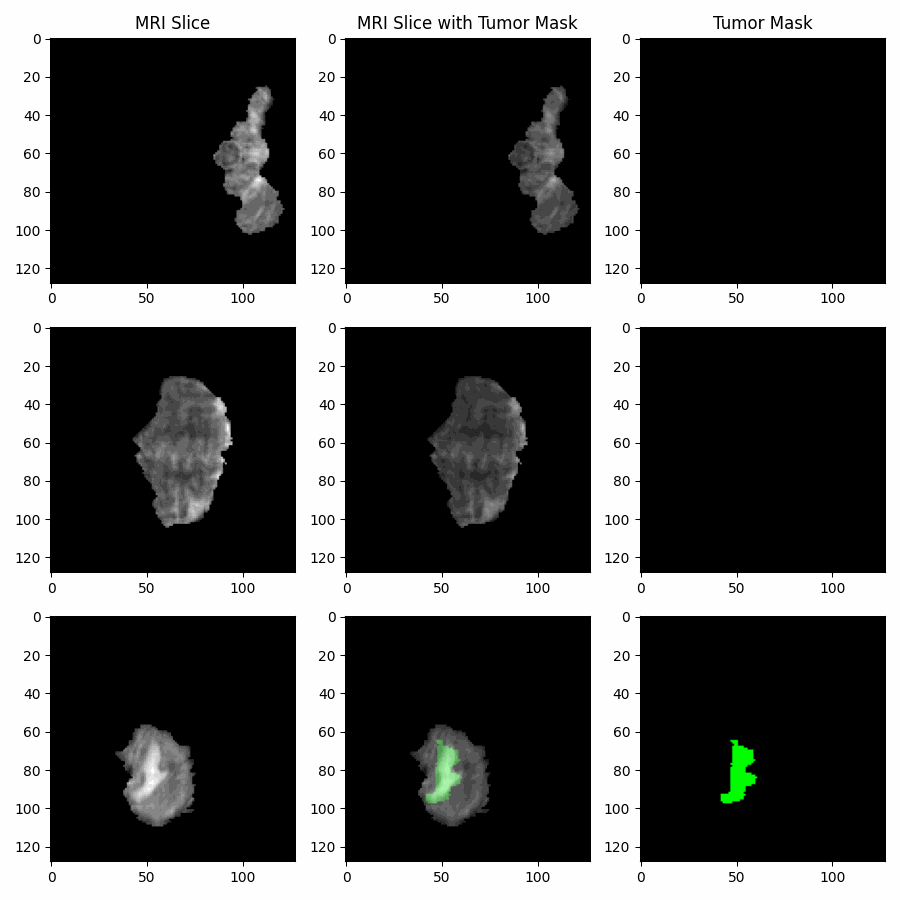

In [ ]:
###### Visualize the output

from IPython.display import display, Image
display(Image(filename="brain_mri.gif"))

In [ ]:
from PIL import Image


In [ ]:
###### GIF showing the MRI and the different tumor masks seperately

def create_mri_gif_2(msk, img, output_gif):
    num_slices = msk.shape[0]

    # Create an empty list to store the individual MRI slice images
    images = []

    for i in range(num_slices):
        # Select the MRI slice
        mri_slice = img[i]

        # Create separate masks for classes 1, 2, and 3
        mask_class1 = (msk[i, :, :, 1] == 1)  # Class 1
        mask_class2 = (msk[i, :, :, 2] == 1)  # Class 2
        mask_class3 = (msk[i, :, :, 3] == 1)  # Class 3

        # Create a figure with four subplots
        fig, axes = plt.subplots(1, 4, figsize=(16, 4))

        # Display the MRI slice
        axes[0].imshow(mri_slice, cmap='gray')
        axes[0].set_title('MRI Slice')

        # Display Class 1 mask
        axes[1].imshow(mask_class1, cmap='Blues')
        axes[1].set_title('Class 1 Mask')

        # Display Class 2 mask
        axes[2].imshow(mask_class2, cmap='Greens')
        axes[2].set_title('Class 2 Mask')

        # Display Class 3 mask
        axes[3].imshow(mask_class3, cmap='Oranges')
        axes[3].set_title('Class 3 Mask')

        # Save the figure to a temporary image file
        temp_image_path = f'temp_image_{i}.png'
        fig.tight_layout()
        plt.savefig(temp_image_path)

        # Close the figure to free up memory
        plt.close(fig)

        # Open the saved image and append it to the list of images
        img_pil = Image.open(temp_image_path)
        images.append(img_pil)

        # Clean up temporary image files
        os.remove(temp_image_path)

    # Save the list of images as a GIF
    images[0].save(output_gif, save_all=True, append_images=images[1:], loop=0, duration=200)

# Example
output_gif = "brain_mri.gif"
create_mri_gif_2(msk[0], img[0], output_gif)

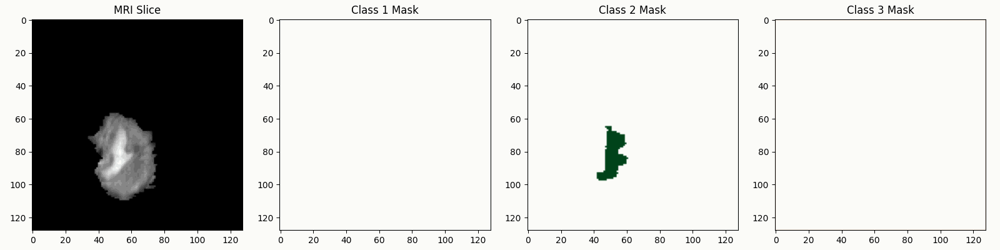

In [ ]:
###### Visualize the output

from IPython.display import display, Image
display(Image(filename="brain_mri.gif"))

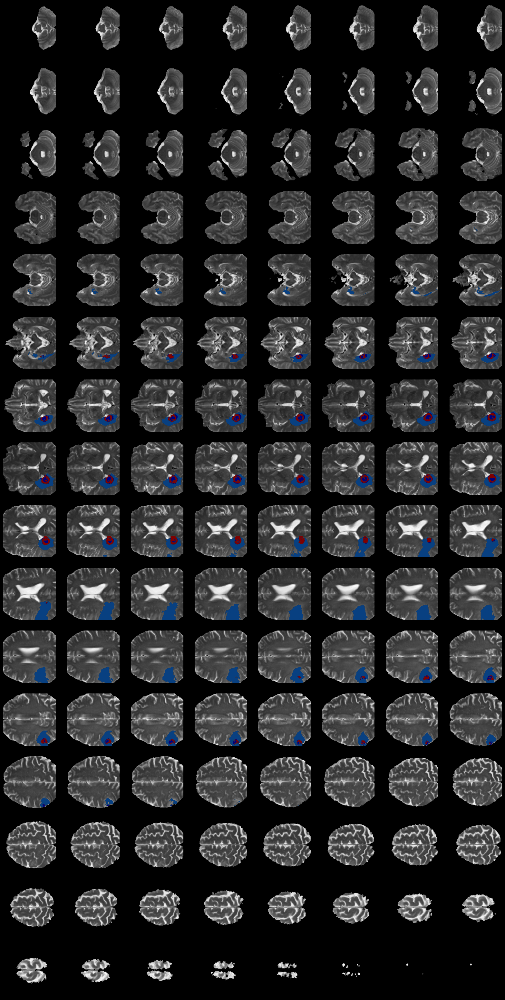

In [ ]:
###### 2D montage of the MRI slices with the corresponding masks

def create_2D_montage(image, mask, output_filename):
    num_slices = image.shape[2]
    num_classes = mask.shape[3]

    fig, axes = plt.subplots(16, 8, figsize=(20, 40))
    axes = axes.ravel()

    for i in range(num_slices):

        axes[i].imshow(image[:, :, i], cmap='gray')

        axes[i].imshow(np.ma.masked_where(mask[:, :, i, 1] == 0, mask[:, :, i, 1]),cmap='jet', alpha=1)
        axes[i].imshow(np.ma.masked_where(mask[:, :, i, 2] == 0, mask[:, :, i, 2]),cmap='GnBu_r', alpha=1)
        axes[i].imshow(np.ma.masked_where(mask[:, :, i, 3] == 0, mask[:, :, i, 3]),cmap='jet_r', alpha=1)

        axes[i].axis('off')

    fig.set_facecolor('black')
    plt.savefig(output_filename, format='png', bbox_inches='tight', pad_inches=0.0)

# Example
output_filename = 'output_2d_montage.png'
create_2D_montage(img[1], msk[1], output_filename)